In [0]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import glob
import json
from wordcloud import WordCloud
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

In [0]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')
from nltk.corpus import wordnet
from nltk.corpus import stopwords
from nltk import WordNetLemmatizer
from nltk.stem import WordNetLemmatizer
from nltk.sentiment.vader import SentimentIntensityAnalyzer

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [0]:
from tqdm import tqdm
tqdm.pandas()

import scipy as sp
from sklearn import metrics
from sklearn.utils import shuffle
from gensim.models import Word2Vec
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [0]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [0]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
downloaded = drive.CreateFile({'id': '116bnBGufA7-dM792wHK2HMsKqKTpeOxo'})
downloaded.GetContentFile('CORD-19-research-challenge.zip')

In [0]:
downloaded = drive.CreateFile({'id': '17PjmHDdoXr2FK3BXsyidO-WmN-km5bTG'})
downloaded.GetContentFile('model.zip')

In [0]:
downloaded = drive.CreateFile({'id': '1sYsXTi8DC2Cv6kgn_-NcdqEYzjt4kIYG'})
downloaded.GetContentFile('model_glove.bin')

In [0]:
# !wget 'http://nlp.stanford.edu/data/glove.6B.zip'
!unzip model.zip

Archive:  model.zip
  inflating: model.bin               


In [0]:
!wget  'http://wiki-news-300d-1M.vec.zip'


--2020-05-07 13:15:07--  http://wiki-news-300d-1m.vec.zip/
Resolving wiki-news-300d-1m.vec.zip (wiki-news-300d-1m.vec.zip)... failed: Name or service not known.
wget: unable to resolve host address ‘wiki-news-300d-1m.vec.zip’


In [0]:
!unzip CORD-19-research-challenge.zip 

Streaming output truncated to the last 5000 lines.
  inflating: custom_license/custom_license/pmc_json/PMC7123607.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123609.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123610.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123611.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123612.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123615.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123619.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123622.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123625.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123626.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123627.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC7123629.xml.json  
  inflating: custom_license/custom_license/pmc_json/PMC712363

In [0]:
!mkdir CORD-19
!mv biorxiv_medrxiv /content/CORD-19/
!mv comm_use_subset /content/CORD-19/
!mv noncomm_use_subset /content/CORD-19/
!mv custom_license /content/CORD-19

In [0]:
!cd /content/CORD-19/
!ls

adc.json			      COVID.DATA.LIC.AGMT.pdf  metadata.readme
CORD-19				      enwik9.zip	       model_glove.bin
CORD-19-research-challenge.zip	      json_schema.txt	       model.zip
cord19_specter_embeddings_2020-04-10  metadata.csv	       sample_data


In [0]:
metadata_path = 'metadata.csv'
meta_df = pd.read_csv(metadata_path, dtype={
    'pubmed_id': str,
    'Microsoft Academic Paper ID': str, 
    'doi': str
})
meta_df.head()

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,Microsoft Academic Paper ID,WHO #Covidence,has_pdf_parse,has_pmc_xml_parse,full_text_file,url
0,xqhn0vbp,1e1286db212100993d03cc22374b624f7caee956,PMC,Airborne rhinovirus detection and effect of ul...,10.1186/1471-2458-3-5,PMC140314,12525263,no-cc,"BACKGROUND: Rhinovirus, the most common cause ...",2003-01-13,"Myatt, Theodore A; Johnston, Sebastian L; Rudn...",BMC Public Health,NaN,NaN,True,True,custom_license,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC1...
1,gi6uaa83,8ae137c8da1607b3a8e4c946c07ca8bda67f88ac,PMC,Discovering human history from stomach bacteria,10.1186/gb-2003-4-5-213,PMC156578,12734001,no-cc,Recent analyses of human pathogens have reveal...,2003-04-28,"Disotell, Todd R",Genome Biol,NaN,NaN,True,True,custom_license,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC1...
2,le0ogx1s,NaN,PMC,A new recruit for the army of the men of death,10.1186/gb-2003-4-7-113,PMC193621,12844350,no-cc,"The army of the men of death, in John Bunyan's...",2003-06-27,"Petsko, Gregory A",Genome Biol,NaN,NaN,False,True,custom_license,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC1...
3,fy4w7xz8,0104f6ceccf92ae8567a0102f89cbb976969a774,PMC,Association of HLA class I with severe acute r...,10.1186/1471-2350-4-9,PMC212558,12969506,no-cc,BACKGROUND: The human leukocyte antigen (HLA) ...,2003-09-12,"Lin, Marie; Tseng, Hsiang-Kuang; Trejaut, Jean...",BMC Med Genet,NaN,NaN,True,True,custom_license,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2...
4,0qaoam29,5b68a553a7cbbea13472721cd1ad617d42b40c26,PMC,A double epidemic model for the SARS propagation,10.1186/1471-2334-3-19,PMC222908,12964944,no-cc,BACKGROUND: An epidemic of a Severe Acute Resp...,2003-09-10,"Ng, Tuen Wai; Turinici, Gabriel; Danchin, Antoine",BMC Infect Dis,NaN,NaN,True,True,custom_license,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2...


In [0]:
all_json = glob.glob(f'/content/CORD-19/**/**/pmc_json/*.json', recursive=True)
len(all_json)

57501

In [0]:
with open(all_json[0]) as file:
    first_entry = json.load(file)
    print(json.dumps(first_entry, indent=4))

{
    "paper_id": "PMC5312796",
    "metadata": {
        "title": "Justifications for Non-Consensual Medical Intervention: From Infectious Disease Control to Criminal Rehabilitation",
        "authors": [
            {
                "first": "Jonathan",
                "middle": [],
                "last": "Pugh",
                "suffix": "",
                "email": null,
                "affiliation": {}
            },
            {
                "first": "Thomas",
                "middle": [],
                "last": "Douglas",
                "suffix": "",
                "email": null,
                "affiliation": {}
            }
        ]
    },
    "body_text": [
        {
            "text": "The putative requirement to obtain valid consent before performing a medical intervention is standardly thought to derive from a reason to respect the prospective patient\u2019s rights, which may include rights to personal autonomy and rights to freedom from bodily interference. P

In [0]:
class FileReader:
    def __init__(self, file_path):
        with open(file_path) as file:
            content = json.load(file)
            self.paper_id = content['paper_id']
            self.abstract = []
            self.body_text = []
            # Abstract
            if 'abstract' in content:
                for entry in content["abstract"]:
                    self.abstract.append(entry['text'])
            else:
                self.abstract.append('Abstract is not present.')
            # Body text
            for entry in content['body_text']:
                self.body_text.append(entry['text'])
            self.abstract = '\n'.join(self.abstract)
            self.body_text = '\n'.join(self.body_text)
            # Extend Here
            #
            #
    def __repr__(self):
        return f'{self.paper_id}: {self.abstract[:200]}... {self.body_text[:200]}...'
first_row = FileReader(all_json[0])
print(first_row)

PMC7122085: Abstract is not present.... 
The new Zika epidemic has many similarities and parallels with the HIV/AIDS pandemic that commenced more than 30 years ago.Ignoring the rapidly emerging prevalence of the ZikaV globally has the poten...


In [0]:
dict_ = {'paper_id': [], 'abstract': [], 'body_text': []}
for idx, entry in enumerate(all_json):
    if idx % (len(all_json) // 100) == 0:
        print(f'Processing index: {idx} of {len(all_json)}')
    content = FileReader(entry)
    dict_['paper_id'].append(content.paper_id)
    dict_['abstract'].append(content.abstract)
    dict_['body_text'].append(content.body_text)


Processing index: 0 of 57501
Processing index: 575 of 57501
Processing index: 1150 of 57501
Processing index: 1725 of 57501
Processing index: 2300 of 57501
Processing index: 2875 of 57501
Processing index: 3450 of 57501
Processing index: 4025 of 57501
Processing index: 4600 of 57501
Processing index: 5175 of 57501
Processing index: 5750 of 57501
Processing index: 6325 of 57501
Processing index: 6900 of 57501
Processing index: 7475 of 57501
Processing index: 8050 of 57501
Processing index: 8625 of 57501
Processing index: 9200 of 57501
Processing index: 9775 of 57501
Processing index: 10350 of 57501
Processing index: 10925 of 57501
Processing index: 11500 of 57501
Processing index: 12075 of 57501
Processing index: 12650 of 57501
Processing index: 13225 of 57501
Processing index: 13800 of 57501
Processing index: 14375 of 57501
Processing index: 14950 of 57501
Processing index: 15525 of 57501
Processing index: 16100 of 57501
Processing index: 16675 of 57501
Processing index: 17250 of 57501

In [0]:
df_covid = pd.DataFrame(dict_, columns=['paper_id', 'abstract', 'body_text'])
df_covid.head()

,paper_id,abstract,body_text
0,PMC7122085,Abstract is not present.,\nThe new Zika epidemic has many similarities ...
1,PMC7120770,Abstract is not present.,Proteolysis represents one of the key processe...
2,PMC7087294,Abstract is not present.,
3,PMC7122664,Abstract is not present.,Severe fever with thrombocytopenia syndrome (S...
4,PMC7120746,Abstract is not present.,Polymerase chain reaction (PCR) has been appli...


In [0]:
df_covid['abstract_word_count'] = df_covid['abstract'].apply(lambda x: len(x.strip().split()))
df_covid['body_word_count'] = df_covid['body_text'].apply(lambda x: len(x.strip().split()))
df_covid.head()

,paper_id,abstract,body_text,abstract_word_count,body_word_count
0,PMC7122085,Abstract is not present.,\nThe new Zika epidemic has many similarities ...,4,2790
1,PMC7120770,Abstract is not present.,Proteolysis represents one of the key processe...,4,6129
2,PMC7087294,Abstract is not present.,,4,0
3,PMC7122664,Abstract is not present.,Severe fever with thrombocytopenia syndrome (S...,4,5190
4,PMC7120746,Abstract is not present.,Polymerase chain reaction (PCR) has been appli...,4,1638


In [0]:
df_covid.describe(include='all')

,paper_id,abstract,body_text,abstract_word_count,body_word_count
count,57501,57501,57501,57501.0,57501.000000
unique,19167,1,17244,NaN,NaN
top,PMC3693495,Abstract is not present.,,NaN,NaN
freq,3,57501,5742,NaN,NaN
mean,NaN,NaN,NaN,4.0,3766.103146
std,NaN,NaN,NaN,0.0,8843.157967
min,NaN,NaN,NaN,4.0,0.000000
25%,NaN,NaN,NaN,4.0,1829.000000
50%,NaN,NaN,NaN,4.0,3225.000000
75%,NaN,NaN,NaN,4.0,4802.000000


In [0]:
df_covid.drop_duplicates(['body_text'], inplace=True)
df_covid.describe(include='all')

,paper_id,abstract,body_text,abstract_word_count,body_word_count
count,17244,17244,17244,17244.0,17244.000000
unique,17244,1,17244,NaN,NaN
top,PMC4882816,Abstract is not present.,"In recent years, flexible endoscope reprocessi...",NaN,NaN
freq,1,17244,1,NaN,NaN
mean,NaN,NaN,NaN,4.0,4186.077708
std,NaN,NaN,NaN,0.0,9228.632407
min,NaN,NaN,NaN,4.0,0.000000
25%,NaN,NaN,NaN,4.0,2373.000000
50%,NaN,NaN,NaN,4.0,3480.000000
75%,NaN,NaN,NaN,4.0,5014.250000


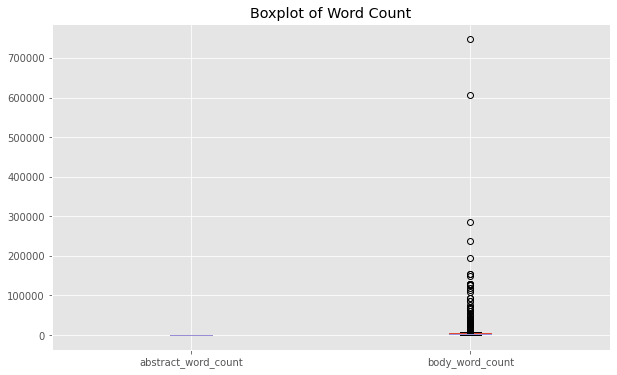

In [0]:
df_covid[['abstract_word_count', 'body_word_count']].plot(kind='box', title='Boxplot of Word Count', figsize=(10,6))
plt.show()

In [0]:
def nonan(x):
    if type(x) == str:
        return x.replace("\n", "")
    else:
        return ""

text = ' '.join([nonan(body_text) for body_text in df_covid["body_text"]])
wordcloud = WordCloud(max_font_size=None, background_color='white', collocations=False,
                      width=1200, height=1000).generate(text)
fig = px.imshow(wordcloud)
fig.update_layout(title_text='Common words in body_text')

In [0]:
def nltk_tag_to_wordnet_tag(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ

    elif nltk_tag.startswith('V'):
        return wordnet.VERB

    elif nltk_tag.startswith('N'):
        return wordnet.NOUN

    elif nltk_tag.startswith('R'):
        return wordnet.ADV

    else:          
        return None

def lemmatize_sentence(sentence):
    nltk_tagged = nltk.pos_tag(nltk.word_tokenize(sentence))
    wordnet_tagged = map(lambda x: (x[0], nltk_tag_to_wordnet_tag(x[1])), nltk_tagged)
    lemmatized_sentence = []

    for word, tag in wordnet_tagged:
        if tag is None:
            lemmatized_sentence.append(word)
        else:
            lemmatized_sentence.append(lemmatizer.lemmatize(word, tag))

    return " ".join(lemmatized_sentence)

def clean_text(abstract):
    abstract = abstract.replace(". ", " ").replace(", ", " ").replace("! ", " ")\
                       .replace("? ", " ").replace(": ", " ").replace("; ", " ")\
                       .replace("( ", " ").replace(") ", " ").replace("| ", " ").replace("/ ", " ")
    if "." in abstract or "," in abstract or "!" in abstract or "?" in abstract or ":" in abstract or ";" in abstract or "(" in abstract or ")" in abstract or "|" in abstract or "/" in abstract:
        abstract = abstract.replace(".", " ").replace(",", " ").replace("!", " ")\
                           .replace("?", " ").replace(":", " ").replace(";", " ")\
                           .replace("(", " ").replace(")", " ").replace("|", " ").replace("/", " ")
    abstract = abstract.replace("  ", " ")
    
    for word in list(set(stopwords.words("english"))):
        abstract = abstract.replace(" " + word + " ", " ")

    return lemmatize_sentence(abstract).lower()

def get_similar_words(word, num):
    vec = model.wv[word].T
    # distances = np.linalg.norm(model.wv.subtract(model.wv[word], 
    #                                                 axis=0).values, axis=0)

    top_words = []
    similarities = []
    for (top_word,similarity) in model.wv.most_similar(keyword,topn=num):
        top_words.append(top_word)
        similarities.append(similarity)
    return top_words

def visualize_word_list(color, word):
    top_words = get_similar_words(word, num=6)
    relevant_words = [get_similar_words(word, num=8) for word in top_words]
    fig = make_subplots(rows=3, cols=2, subplot_titles=tuple(top_words), vertical_spacing=0.05)
    for idx, word_list in enumerate(relevant_words):
        words = [word for word in word_list if word in model.wv.vocab]
        X = model.wv[words]
        pca = PCA(n_components=2)
        result = pca.fit_transform(X)
        df = pd.DataFrame(result, columns=["Component 1", "Component 2"])
        df["Word"] = word_list
        word_emb = df[["Component 1", "Component 2"]].loc[0]
        df["Distance"] = np.sqrt((df["Component 1"] - word_emb[0])**2 + (df["Component 2"] - word_emb[1])**2)
        plot = px.scatter(df, x="Component 1", y="Component 2", text="Word", color="Distance", color_continuous_scale=color, size="Distance")
        plot.layout.title = top_words[idx]
        plot.update_traces(textposition='top center')
        plot.layout.xaxis.autorange = True
        plot.data[0].marker.line.width = 1
        plot.data[0].marker.line.color = 'rgb(0, 0, 0)'
        fig.add_trace(plot.data[0], row=(idx//2)+1, col=(idx%2)+1)
    fig.layout.coloraxis.showscale = False
    fig.update_layout(height=1400, title_text="2D PCA of words related to {}".format(word), paper_bgcolor="#f0f0f0", template="plotly_white")
    return fig

def visualize_word(color, word):
    top_words = get_similar_words(word, num=20)
    words = [word for word in top_words if word in model.wv.vocab]
    X = model.wv[words]
    pca = PCA(n_components=2)
    result = pca.fit_transform(X)
    df = pd.DataFrame(result, columns=["Component 1", "Component 2"])
    df["Word"] = top_words
    if word == "antimalarial":
        df = df.query("Word != 'anti-malarial' and Word != 'anthelmintic'")
    if word == "doxorubicin":
        df = df.query("Word != 'anti-rotavirus'")
    word_emb = df[["Component 1", "Component 2"]].loc[0]
    df["Distance"] = np.sqrt((df["Component 1"] - word_emb[0])**2 + (df["Component 2"] - word_emb[1])**2)
    fig = px.scatter(df, x="Component 1", y="Component 2", text="Word", color="Distance", color_continuous_scale=color, size="Distance")
    fig.layout.title = word
    fig.update_traces(textposition='top center')
    fig.layout.xaxis.autorange = True
    fig.layout.coloraxis.showscale = True
    fig.data[0].marker.line.width = 1
    fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
    fig.update_layout(height=800, title_text="2D PCA of words related to {}".format(word), template="plotly_white", paper_bgcolor="#f0f0f0")
    fig.show()

In [0]:
lemmatizer = WordNetLemmatizer()

def get_words(abstract):
    return clean_text(nonan(abstract)).split(" ")

words = df_covid["body_text"].progress_apply(get_words)
words

In [0]:
words[44][0]


In [0]:
# words = papers_df["abstract"].progress_apply(get_words)
# model = Word2Vec(words, size=200, sg=1, min_count=1, window=8, hs=0, negative=15, workers=2)
from gensim.scripts.glove2word2vec import glove2word2vec
glove_input_file = 'glove.6B.200d.txt'
word2vec_output_file = 'glove.6B.200d.txt.word2vec'
glove2word2vec(glove_input_file,word2vec_output_file)

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:253: UserWarning:

This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function



FileNotFoundError: ignored

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
from gensim.models import KeyedVectors
model = KeyedVectors.load_word2vec_format(word2vec_output_file,binary = False)

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:410: UserWarning:

This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function



In [0]:
path = f'/content/model.bin'
f = glob.glob(path, recursive=True)

In [0]:
model_2 = KeyedVectors.load_word2vec_format('model_glove.bin',binary = True)

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:410: UserWarning:

This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function



In [0]:
model_1 = KeyedVectors.load_word2vec_format(path,binary = True)

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:410: UserWarning:

This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function



In [0]:
list(model.wv.vocab)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



['the',
 ',',
 '.',
 'of',
 'to',
 'and',
 'in',
 'a',
 '"',
 "'s",
 'for',
 '-',
 'that',
 'on',
 'is',
 'was',
 'said',
 'with',
 'he',
 'as',
 'it',
 'by',
 'at',
 '(',
 ')',
 'from',
 'his',
 "''",
 '``',
 'an',
 'be',
 'has',
 'are',
 'have',
 'but',
 'were',
 'not',
 'this',
 'who',
 'they',
 'had',
 'i',
 'which',
 'will',
 'their',
 ':',
 'or',
 'its',
 'one',
 'after',
 'new',
 'been',
 'also',
 'we',
 'would',
 'two',
 'more',
 "'",
 'first',
 'about',
 'up',
 'when',
 'year',
 'there',
 'all',
 '--',
 'out',
 'she',
 'other',
 'people',
 "n't",
 'her',
 'percent',
 'than',
 'over',
 'into',
 'last',
 'some',
 'government',
 'time',
 '$',
 'you',
 'years',
 'if',
 'no',
 'world',
 'can',
 'three',
 'do',
 ';',
 'president',
 'only',
 'state',
 'million',
 'could',
 'us',
 'most',
 '_',
 'against',
 'u.s.',
 'so',
 'them',
 'what',
 'him',
 'united',
 'during',
 'before',
 'may',
 'since',
 'many',
 'while',
 'where',
 'states',
 'because',
 'now',
 'city',
 'made',
 'like',
 

In [0]:
model.add(list(model_1.wv.vocab),model_1.wv[list(model_1.wv.vocab)],replace = True)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



In [0]:
(model.wv[list(model.wv.vocab)]).shape

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



(510931, 200)

In [0]:
model.wv.most_similar('coronavirus')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



[('coronaviruses', 0.7478286027908325),
 ('cov', 0.7367061972618103),
 ('-cov', 0.7299067974090576),
 ('syndrome-cov', 0.7158098220825195),
 ('ß-cov', 0.7049785256385803),
 ('beta-coronavirus', 0.6977931261062622),
 ('syndromeassociated', 0.6877391338348389),
 ('sarsassociated', 0.6870981454849243),
 ('-coronavirus', 0.6869629621505737),
 ('-middle', 0.6846431493759155)]

In [0]:
model.wv.vocab

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



{'the': <gensim.models.keyedvectors.Vocab at 0x7fd424356278>,
 ',': <gensim.models.keyedvectors.Vocab at 0x7fd4242d4128>,
 '.': <gensim.models.keyedvectors.Vocab at 0x7fd4247bdd30>,
 'of': <gensim.models.keyedvectors.Vocab at 0x7fd4242d4ba8>,
 'to': <gensim.models.keyedvectors.Vocab at 0x7fd4243562b0>,
 'and': <gensim.models.keyedvectors.Vocab at 0x7fd4242d4c50>,
 'in': <gensim.models.keyedvectors.Vocab at 0x7fd424356320>,
 'a': <gensim.models.keyedvectors.Vocab at 0x7fd4242d4588>,
 '"': <gensim.models.keyedvectors.Vocab at 0x7fd424356358>,
 "'s": <gensim.models.keyedvectors.Vocab at 0x7fd4242d4d68>,
 'for': <gensim.models.keyedvectors.Vocab at 0x7fd4243563c8>,
 '-': <gensim.models.keyedvectors.Vocab at 0x7fd4242d4ef0>,
 'that': <gensim.models.keyedvectors.Vocab at 0x7fd424356400>,
 'on': <gensim.models.keyedvectors.Vocab at 0x7fd4242d4908>,
 'is': <gensim.models.keyedvectors.Vocab at 0x7fd424356470>,
 'was': <gensim.models.keyedvectors.Vocab at 0x7fd4242d4b00>,
 'said': <gensim.models

In [0]:
words = list(model.wv.vocab)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



In [0]:
len(words)

510931

In [0]:
model.wv.save_word2vec_format('model.bin',binary = True)

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:410: UserWarning:

This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function



In [0]:
(model.wv['medicine','coronavirus']).shape

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



(2, 200)

In [0]:
keywords = ["infection", "cell", "protein", "virus",\
            "disease", "respiratory", "influenza", "viral",\
            "rna", "patient", "pathogen", "human", "medicine",\
            "cov", "antiviral"]

print("Most similar words to keywords")
print("")

top_words_list = []
similarities_list = []
for jdx, keyword in enumerate(keywords):
    vec = model.wv[keyword].T
    print(keyword + ":")
    # distances = np.linalg.norm(model_wv_df.subtract(model_wv_df[word], 
    #                                                 axis=0).values, axis=0)

    # indices = np.argsort(distances)
    # top_distances = distances[indices[1:11]]
    top_words = []
    similarities = []
    for (top_word,similarity) in model.wv.most_similar(keyword,topn=10):
        top_words.append(top_word)
        similarities.append(similarity)
    similarities_list.append(similarities)
    top_words_list.append(top_words)
    for idx, word in enumerate(top_words):
        print(str(idx+1) + ". " + word)
    print("")

Most similar words to keywords

infection:
1. predisposes
2. selflimiting
3. re-infection
4. ureaplasmas
5. complicates
6. oligosymptomatic
7. hmpv-and
8. post-influenza
9. coincidental
10. mid-gestation

cell:
1. ceils
2. hepatocarcinoma
3. ags
4. co-cultured
5. modc
6. h1299
7. lymphoblastoid
8. fibroblasts
9. aecii
10. mucus-producing

protein:
1. proteins
2. nonglycosylated
3. refolded
4. vp60
5. post-translationally
6. nlss
7. rgst-s1d
8. rgst-coe
9. muhn
10. 29-kda

virus:
1. viruses
2. viral
3. exanthema
4. orthopox
5. rna-viruses
6. vesv
7. mycoplasmas
8. parvoviruses
9. h3n8
10. metapneumo

disease:


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



1. diseases
2. regimes
3. pernicious
4. flare-up
5. bartonellosis
6. echinococcosis
7. multi-factorial
8. human-only
9. threatening
10. rids

respiratory:
1. lower-respiratory
2. alrtis
3. upper-respiratory
4. pneumonia-like
5. lower-respiratory-tract
6. saris
7. cold-like
8. mono-infections
9. alrti
10. alris

influenza:
1. h1n1
2. flu
3. pdm09
4. swine-origin
5. h3n2
6. 2009-h1n1
7. non-influenza
8. influenzas
9. h2n2
10. h7n7

viral:
1. virus
2. single-and
3. acid-stability
4. rapidly-propagating
5. pre-or
6. viralinduced
7. interfered
8. infected-cell
9. post-viral
10. well-understood

rna:
1. rnas
2. plus-strand
3. templates
4. encapsidation
5. vrna
6. negative-strand
7. positivestrand
8. sgmrnas
9. tombusviruses
10. genomic-sized

patient:
1. patients
2. n=25
3. aptb
4. tonsillectomy
5. admitted
6. fridu
7. discharged
8. died
9. intubated
10. hiv-negative

pathogen:
1. pathogens
2. microbe
3. livestock-related
4. antimicrobial-resistant
5. slow-growing
6. microbes
7. facultative


In [0]:
words = [word for word in keywords if word in model.wv.vocab]
X = model.wv[words]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
df = pd.DataFrame(result, columns=["Component 1", "Component 2"])
df["Word"] = keywords
df["Distance"] = np.sqrt(df["Component 1"]**2 + df["Component 2"]**2)
fig = px.scatter(df, x="Component 1", y="Component 2", text="Word", color="Distance", color_continuous_scale="agsunset",size="Distance")
fig.update_traces(textposition='top center')
fig.layout.xaxis.autorange = True
fig.data[0].marker.line.width = 1
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.update_layout(height=800, title_text="2D PCA of Word2Vec embeddings", template="plotly_white", paper_bgcolor="#f0f0f0")
fig.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



In [0]:
words = [word for word in keywords if word in model.wv.vocab]
X = model.wv[words]
pca = PCA(n_components=3)
result = pca.fit_transform(X)
df = pd.DataFrame(result, columns=["Component 1", "Component 2", "Component 3"])
df["Word"] = keywords
df["Distance"] = np.sqrt(df["Component 1"]**2 + df["Component 2"]**2 + df["Component 3"]**2)
fig = px.scatter_3d(df, x="Component 1", y="Component 2", z="Component 3", text="Word", color="Distance", color_continuous_scale="agsunset")
fig.update_traces(textposition='top left')
fig.layout.coloraxis.showscale = False
fig.layout.xaxis.autorange = True
fig.update_layout(height=800, title_text="3D PCA of Word2Vec embeddings", template="plotly")
fig.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



In [0]:
words = [word for word in top_words_list[6] if word in model.wv.vocab]
X = model.wv[words]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
df = pd.DataFrame(result, columns=["Component 1", "Component 2"])
df["Word"] = top_words_list[6]
word_emb = df[["Component 1", "Component 2"]].loc[0]
df["Distance"] = np.sqrt((df["Component 1"] - word_emb[0])**2 + (df["Component 2"] - word_emb[1])**2)
fig = px.scatter(df.query("Word != 'uenza'"), x="Component 1", y="Component 2", text="Word", color="Distance", color_continuous_scale="aggrnyl",size="Distance")

"""for row in range(len(df)):
    fig.add_shape(
                type="line",
                x0=word_emb[0],
                y0=word_emb[1],
                x1=df["Component 1"][row],
                y1=df["Component 2"][row],
                line=dict(
                    color="Green",
                    width=0.75,
                    dash="dot"
                )
    )"""

fig.update_traces(textposition='top center')
fig.layout.xaxis.autorange = True
fig.data[0].marker.line.width = 1
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.update_layout(height=800, title_text="2D PCA of words related to {}".format(keywords[6]), template="plotly_white", paper_bgcolor="#f0f0f0")
fig.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



In [0]:
fig = visualize_word('agsunset', 'anti-hcmv')
fig.update_layout(colorscale=dict(diverging=px.colors.diverging.Tealrose))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:42: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:79: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:80: DeprecationWarning:

Call to deprecated `wv` (Attribute will be removed in 4.0.0, use self instead).



AttributeError: ignored

In [0]:
from gensim.models import FastText

In [0]:
ft=FastText.load_fasttext_format("fasttext_embedding.bin")

FileNotFoundError: ignored

In [0]:
!wget  'http://mattmahoney.net/dc/enwik9.zip'

In [0]:
!unzip enwik9.zip

Archive:  enwik9.zip
  inflating: enwik9                  


In [0]:
!git clone https://github.com/facebookresearch/fastText.git


Cloning into 'fastText'...
remote: Enumerating objects: 12, done.
remote: Counting objects: 100% (12/12), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 3826 (delta 1), reused 4 (delta 0), pack-reused 3814
Receiving objects: 100% (3826/3826), 8.21 MiB | 34.02 MiB/s, done.
Resolving deltas: 100% (2402/2402), done.


In [0]:
!wget https://github.com/facebookresearch/fastText/archive/v0.9.2.zip

--2020-05-07 17:10:28--  https://github.com/facebookresearch/fastText/archive/v0.9.2.zip
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/facebookresearch/fastText/zip/v0.9.2 [following]
--2020-05-07 17:10:28--  https://codeload.github.com/facebookresearch/fastText/zip/v0.9.2
Resolving codeload.github.com (codeload.github.com)... 140.82.113.9
Connecting to codeload.github.com (codeload.github.com)|140.82.113.9|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘v0.9.2.zip’

v0.9.2.zip              [  <=>               ]   4.17M  14.9MB/s    in 0.3s    

2020-05-07 17:10:29 (14.9 MB/s) - ‘v0.9.2.zip’ saved [4369852]



In [0]:
!unzip v0.9.2.zip

Archive:  v0.9.2.zip
5b5943c118b0ec5fb9cd8d20587de2b2d3966dfe
   creating: fastText-0.9.2/
   creating: fastText-0.9.2/.circleci/
  inflating: fastText-0.9.2/.circleci/cmake_test.sh  
  inflating: fastText-0.9.2/.circleci/config.yml  
  inflating: fastText-0.9.2/.circleci/gcc_test.sh  
  inflating: fastText-0.9.2/.circleci/pip_test.sh  
  inflating: fastText-0.9.2/.circleci/pull_data.sh  
  inflating: fastText-0.9.2/.circleci/python_test.sh  
  inflating: fastText-0.9.2/.circleci/run_locally.sh  
  inflating: fastText-0.9.2/.circleci/setup_circleimg.sh  
  inflating: fastText-0.9.2/.circleci/setup_debian.sh  
  inflating: fastText-0.9.2/.gitignore  
  inflating: fastText-0.9.2/CMakeLists.txt  
  inflating: fastText-0.9.2/CODE_OF_CONDUCT.md  
  inflating: fastText-0.9.2/CONTRIBUTING.md  
  inflating: fastText-0.9.2/LICENSE  
  inflating: fastText-0.9.2/MANIFEST.in  
  inflating: fastText-0.9.2/Makefile  
  inflating: fastText-0.9.2/README.md  
   creating: fastText-0.9.2/alignment/
  in

In [0]:
%cd fastText-0.9.2

/content/fastText-0.9.2


In [0]:
!make

c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/args.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/autotune.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/matrix.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/dictionary.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/loss.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/productquantizer.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/densematrix.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/quantmatrix.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/vector.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/model.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -c src/utils.cc
c++ -pthread -std=c++11 -march=native -O3 -funroll-loops -DNDEBUG -

In [0]:
%cd ..


/content


In [0]:
%cd fastText

/content/fastText


In [0]:
!pip install .

Processing /content/fastText
  Created wheel for fasttext: filename=fasttext-0.9.2-cp36-cp36m-linux_x86_64.whl size=3013639 sha256=cb37c75fb5bbf429d811c07f4e163563c467aaee477e937fda0108f11a1c215e
  Stored in directory: /tmp/pip-ephem-wheel-cache-g5yl1bre/wheels/a1/9f/52/696ce6c5c46325e840c76614ee5051458c0df10306987e7443
Successfully built fasttext


In [0]:
import fasttext

In [90]:
import fasttext.util
fasttext.util.download_model('en', if_exists='ignore')  # English
ft = fasttext.load_model('cc.en.300.bin')

Buffered data was truncated after reaching the output size limit.

In [0]:
embedding_size = 60
window_size = 40
min_word = 5
down_sampling = 1e-2

In [0]:
%%time
ft_model = FastText(words,
                      size=embedding_size,
                      window=window_size,
                      min_count=min_word,
                      sample=down_sampling,
                      sg=1,
                      iter=100)

In [0]:
semantically_similar_words = {words: [item[0] for item in ft_model.wv.most_similar([words], topn=5)]
                  for words in ["infection", "cell", "protein", "virus",\
            "disease", "respiratory", "influenza", "viral",\
            "rna", "patient", "pathogen", "human", "medicine",\
            "cov", "antiviral"]}

for k,v in semantically_similar_words.items():
    print(k+":"+str(v))

In [0]:
print(ft_model.wv.similarity(w1='virus', w2='coronavirus'))

In [0]:
#Visualizing 
from sklearn.decomposition import PCA

all_similar_words = sum([[k] + v for k, v in semantically_similar_words.items()], [])

print(all_similar_words)
print(type(all_similar_words))
print(len(all_similar_words))

In [0]:
word_vectors = ft_model.wv[all_similar_words]

pca = PCA(n_components=2)

p_comps = pca.fit_transform(word_vectors)
word_names = all_similar_words

plt.figure(figsize=(18, 10))
plt.scatter(p_comps[:, 0], p_comps[:, 1], c='red')

for word_names, x, y in zip(word_names, p_comps[:, 0], p_comps[:, 1]):
    plt.annotate(word_names, xy=(x+0.06, y+0.03), xytext=(0, 0), textcoords='offset points')